<a href="https://colab.research.google.com/github/faelbcosta/treinamento/blob/main/telegram_flai_nlp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Análise grupo Telegram: Comunidade Flai

O objetivo desse trabalho é utilizar técnicas de NLP (nuvem de palarvas, extração de sentimentos, extração de tópicos etc), montando um código em Python comentado e explicado. Vale ressaltar, que este trabalho foi desenvolvido por Lucas Fávero, estudante do curso de extensão de Processamento de Linguagem Natural (PLN) do ICMC-USP, o qual parabenizo pela excelente iniciativa que oportuniza a possibilidade de outros estudantes na área terem acesso mais fácil a tais ferramentas. Através desse excelente trabalho, realizei as devidas adaptações para a Comunidade Flai, identificando as variáveis e classificando no ranking TOP 20 e a nuvem de palavras mais discutidas no grupo.



In [ ]:
# Importando as bibliotecas
import pandas as pd
import numpy as np
import json
import nltk
import matplotlib.pyplot as plt
import nltk
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

# Configurando a biblioteca pandas para mostrar todos os dados dentro do nosso Dataframe
pd.set_option("display.max_rows", 9999)
pd.set_option("display.max_columns", 99)

Através do Telegram Desktop, realizar a exportação do histórico das conversas em .json, depois incluir o arquivo aqui colab ou no google drive, realizando a importação abaixo.

In [ ]:
# Abrindo o arquivo result.json que contem todas as mensagem extraidas do grupo
f = open("result.json", encoding="utf8")

# Carregando as mensagens do result.json
data = json.load(f)

# Carregando os campos importantes para construção do nosso Dataframe
msgs = data["messages"]

# Printando a estrutura de dados que contem informações sobre as mensagens do grupo
msgs

[{'action': 'migrate_from_group',
  'actor': 'Comunidade FLAI',
  'actor_id': 'channel1424499902',
  'date': '2021-04-30T08:36:23',
  'id': 1,
  'text': '',
  'title': 'Comunidade FLAI',
  'type': 'service'},
 {'date': '2021-04-30T08:45:01',
  'from': 'Vitor Diego',
  'from_id': 'user621311552',
  'id': 2,
  'text': [{'text': '@GroupHelpBot', 'type': 'mention'}],
  'type': 'message'},
 {'action': 'invite_members',
  'actor': 'Vitor Diego',
  'actor_id': 'user621311552',
  'date': '2021-04-30T08:46:06',
  'id': 3,
  'members': ['Group Help'],
  'text': '',
  'type': 'service'},
 {'date': '2021-04-30T08:46:07',
  'from': 'Group Help',
  'from_id': 'user162726413',
  'id': 4,
  'text': [{'text': 'Obrigado', 'type': 'bold'},
   ' por me adicionar como um Administrador no seu grupo!\n',
   {'text': 'Mande um start no meu privado', 'type': 'bold'},
   ', para que eu mande mensagens de erro sem poluir o chat.'],
  'type': 'message'},
 {'date': '2021-04-30T08:46:07',
  'edited': '2021-04-30T08

In [ ]:
# Formatando e limpando a coluna "text" para remover textos desnecessários para análise
remove_strings = ["[", "]", "{", "}", "'type':", "'mention',", "'link',", "'text':", "'user_id':"]

for msg in msgs:
    for string in remove_strings:
        msg["text"] = str(msg["text"]).replace(string, "")

Aqui vamos construir o Dataframe contendo toda a informação extraída do grupo. Nesse momento, nossos campos mais importantes são: "from" que representa de quem é a mensagem, e "text" que é a própria mensagem. 

In [ ]:
# Construindo o Dataframe a partir da variavél msgs que foi formatada
df = pd.DataFrame(msgs)

# Printando o Dataframe
df

,id,type,date,actor,actor_id,action,title,text,from,from_id,members,edited,photo,width,height,reply_to_message_id,message_id,inviter,forwarded_from,poll,file,thumbnail,media_type,sticker_emoji,mime_type,duration_seconds,saved_from
0,1,service,2021-04-30T08:36:23,Comunidade FLAI,channel1424499902,migrate_from_group,Comunidade FLAI,,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,message,2021-04-30T08:45:01,NaN,NaN,NaN,NaN,'@GroupHelpBot',Vitor Diego,user621311552,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3,service,2021-04-30T08:46:06,Vitor Diego,user621311552,invite_members,NaN,,NaN,NaN,[Group Help],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4,message,2021-04-30T08:46:07,NaN,NaN,NaN,NaN,"'bold', 'Obrigado', ' por me adicionar como ...",Group Help,user162726413,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,message,2021-04-30T08:46:07,NaN,NaN,NaN,NaN,"'bold', 'Quem gerencia as configurações?', '...",Group Help,user162726413,NaN,2021-04-30T08:53:36,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,6,message,2021-04-30T08:49:47,NaN,NaN,NaN,NaN,,Ricardo,user791909701,NaN,NaN,(File not included. Change data exporting sett...,576.0,1280.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,7,message,2021-04-30T08:49:59,NaN,NaN,NaN,NaN,Que tal essa foto na capa do grupo?,Ricardo,user791909701,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,8,message,2021-04-30T08:50:08,NaN,NaN,NaN,NaN,show,Vitor Diego,user621311552,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,9,service,2021-04-30T08:50:43,Vitor Diego,user621311552,edit_group_photo,NaN,,NaN,NaN,NaN,NaN,(File not included. Change data exporting sett...,640.0,640.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,10,service,2021-04-30T08:51:11,Vitor Diego,user621311552,edit_group_photo,NaN,,NaN,NaN,NaN,NaN,(File not included. Change data exporting sett...,640.0,640.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Com o Pandas podemos acessar os atributos .shape e .columns, assim podemos verificar as dimensões e colunas do Dataframe. São 9325 registros e 27 colunas. 

In [ ]:
# Estrutura do Dataframe
df.shape

(9325, 27)

In [ ]:
# esse comando exclui os registros em que o campo 'text' possui valores em branco
texto_branco = df.loc[(df['text'] == '')]
df = df.drop(texto_branco.index)

In [ ]:
# esse comando permite localizar e informar a quantidade de registros de um determinado usuário
df.loc[(df['from'] == 'Rafael Batista')].count()

id                     1012
type                   1012
date                   1012
actor                     0
actor_id                  0
action                    0
title                     0
text                   1012
from                   1012
from_id                1012
members                   0
edited                    0
photo                     0
width                     1
height                    1
reply_to_message_id     251
message_id                0
inviter                   0
forwarded_from            1
poll                      0
file                      1
thumbnail                 1
media_type                1
sticker_emoji             0
mime_type                 1
duration_seconds          1
saved_from                0
dtype: int64

In [ ]:
# Nome de todas as colunas do Dataframe
df.columns

Index(['id', 'type', 'date', 'actor', 'actor_id', 'action', 'title', 'text',
       'from', 'from_id', 'members', 'edited', 'photo', 'width', 'height',
       'reply_to_message_id', 'message_id', 'inviter', 'forwarded_from',
       'poll', 'file', 'thumbnail', 'media_type', 'sticker_emoji', 'mime_type',
       'duration_seconds', 'saved_from'],
      dtype='object')

O próximo passo é agrupar as mensagens por autor e plotar os 20 autores com mais mensagens dentro do grupo. Para isso utilizamos os métodos groupby() e plot() do Pandas. 

In [ ]:
# Criando um novo Dataframe que vai receber o agrupamento a partir da coluna "from" que representa os autores das mensagens
# Também usamos o método count()
df_top10_text = df[['text','from']].groupby(['from']).count().sort_values(['text'], ascending=False).head(20)

# Resetando o index do Dataframe 
df_top10_text.reset_index(inplace=True)

# Printando o Dataframe
df_top10_text

,from,text
0,Rafael Batista,1012
1,Ricardo,494
2,Juliana Scudilio,415
3,🤖 Flávia da FLAI,387
4,Jonas,364
5,Luiz Claudio,356
6,Victor Sponchiado,345
7,Victor Araújo,323
8,Filgueiras,261
9,Andre,241


/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 129302 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 129302 missing from current font.
  font.set_text(s, 0, flags=flags)


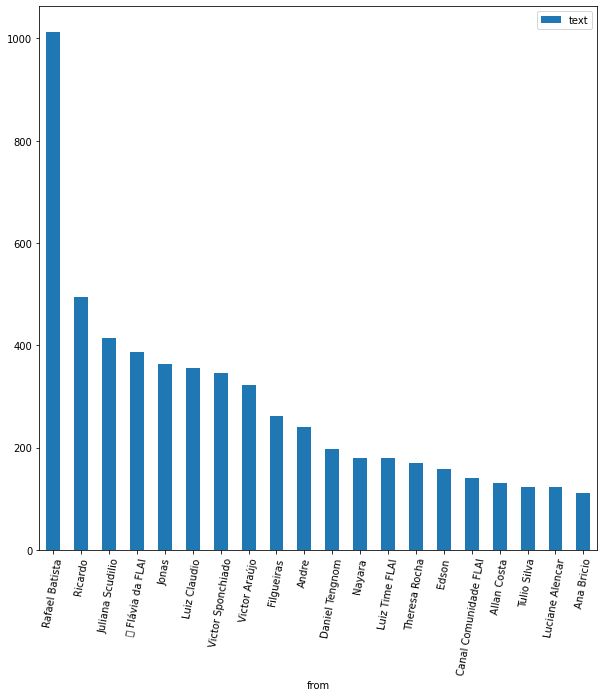

In [ ]:
# Usando o método plot.bar() do Pandas para printar um gráfico de barras do novo Dataframe que foi criado anteriormente
df_top10_text.plot.bar(x= "from", y="text", rot=80, figsize=(10, 10));

# Utilizando a biblioteca WordCloud para construir uma nuvem de palavras

O primeiro passo é coletar todas as mensagens e colocar em uma única variável. E a partir dessa única variavél contendo todas as palavras das mensagens, vamos utilizar a biblioteca WordCloud para imprimir as palavras com maior frequência. 

In [ ]:
# Agrupando todas as mensagens do Dataframe na coluna "text" em uma única variavél.
text = " ".join(text for text in df.text)

# Printando o total de palavras e as mensagens 
print (f"O texto contém {len(text)} palavras.")
print("\n\n")
text

O texto contém 794545 palavras.





'   \'@GroupHelpBot\'  \'bold\',  \'Obrigado\', \' por me adicionar como um Administrador no seu grupo!\\n\',  \'bold\',  \'Mande um start no meu privado\', \', para que eu mande mensagens de erro sem poluir o chat.\'  \'bold\',  \'Quem gerencia as configurações?\', \'\\n\\nTodos os admin ou apenas quem tem permissão para alterar as informações do grupo?\\n\\n\',  \'bold\',  \'Status:\', \' Todos os admins\' Que tal essa foto na capa do grupo? show Tô vendo essas configurações aqui, mas vou deixar pra você ver tudo isso, blz? Aliás, era melhor não estarmos conversando aqui né? Kkk pode falar hehehe depois vou apagar historico Show  \'bot_command\',  \'/settings@GroupHelpBot\'  \'italic\',  \'Te enviei as configurações no chat privado.\', \'\' Esse negócio do Group Help falando, é pra eu fazer alguma coisa? não, só nos adm vemos  \'bot_command\',  \'/me\'  \'text_link\',  \'Enviado em chat privado\', \'href\': \'http://t.me/GroupHelpBot\'  \'bot_command\',  \'/start@GroupHelpBot\'  \'bo

In [ ]:
# Utilizando a biblioteca WordCloud para construir o modelo que faz a contagem da frequência das palavras mais utilizadas
nltk.download('stopwords')
stopwords = nltk.corpus.stopwords.words('portuguese')
wordcloud = WordCloud(stopwords=stopwords, background_color="white", width=1800, height=900).generate(text)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


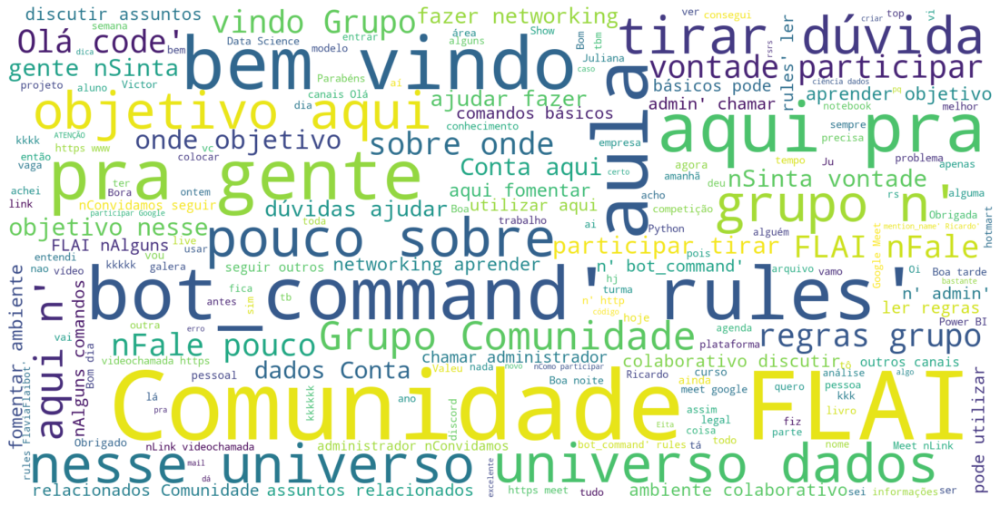

In [ ]:
# Utilizando a biblioteca matplotlib para printar a imagem construída pela WordCloud
plt.figure( figsize=(20,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

Ainda existem alguns termos como: "https, www, kkkkk" que não nos explicam muita coisa e também podem ser removidos, o próximo passo vai ser limpar ainda mais esse modelo, adicionando esses termos na lista de stopwords.

A partir desse momento, a idéia é melhorar os stopwords, fazendo com que as palavras de melhor destaque apareçam na nuvem e trazer novas observações deste trabalho.